<a href="https://colab.research.google.com/github/rajagopalmotivate1/COVID_NanoAID/blob/master/NanoAID_Learning_nCOV_Autoencoder_v20.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **NanoAID, a COVID19 Researcher's toolkit** 
#https://sites.google.com/view/covid19enabler/

In [ ]:
%tensorflow_version 1.x

In [ ]:
!rm -r mynewfiles
!mkdir mynewfiles

In [ ]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=17WYoQaUzn2EFM4lQFya4eLgfmUeKCURn' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=17WYoQaUzn2EFM4lQFya4eLgfmUeKCURn" -O blue2.tar && rm -rf /tmp/cookies.txt

In [ ]:
!wget --load-cookies /tmp/cookies.txt "https://docs.google.com/uc?export=download&confirm=$(wget --quiet --save-cookies /tmp/cookies.txt --keep-session-cookies --no-check-certificate 'https://docs.google.com/uc?export=download&id=1MOzcCLol9EKY-1hEpyzPLOky-NJ39MPK' -O- | sed -rn 's/.*confirm=([0-9A-Za-z_]+).*/\1\n/p')&id=1MOzcCLol9EKY-1hEpyzPLOky-NJ39MPK" -O spike2.tar && rm -rf /tmp/cookies.txt

In [ ]:
!mkdir mynewfiles
!mkdir tempzipfolder

In [ ]:
!tar xvf  spike2.tar -C tempzipfolder

In [ ]:
!tar xvf  blue2.tar -C tempzipfolder

In [ ]:
!mkdir mynewfiles/spike
!mkdir mynewfiles/blue

In [ ]:
!mv tempzipfolder/spike2/*.*    mynewfiles/spike

In [ ]:
!mv tempzipfolder/blue2/*.*    mynewfiles/blue

In [ ]:
!ls mynewfiles

In [ ]:
!mkdir mynewfilesTEM

In [ ]:
!mkdir mynewfilesTEM/blue

In [ ]:
from google.colab import files
#uploaded = files.upload() 


In [ ]:
!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg

In [ ]:
!mv 10.jpg mynewfilesTEM/blue/100.jpg

In [ ]:
import os



rock_dir = os.path.join('mynewfiles/spike')
paper_dir = os.path.join('mynewfiles/blue')

print('total training  images:', len(os.listdir(rock_dir)))
print('total training  images:', len(os.listdir(paper_dir)))

rock_files = os.listdir(rock_dir)
print(rock_files[:10])

paper_files = os.listdir(paper_dir)
print(paper_files[:10])



In [ ]:
SIZE = 224

In [ ]:
import keras
from keras.datasets import mnist
from keras.models import Sequential
from keras.layers import Dense, Activation, Flatten, Input, Dropout
from keras.layers import Conv2D, MaxPooling2D, UpSampling2D
import matplotlib.pyplot as plt
from keras import backend as K
import numpy as np
from keras.preprocessing.image import ImageDataGenerator, array_to_img, img_to_array, load_img

from keras.preprocessing import image 


In [ ]:
DATASETCLASSMODE= 'input'
#DATASETCLASSMODE= 'categorical'

In [ ]:
BATCHSIZE=64

In [ ]:
TRAINING_DIR = "mynewfiles/"

datagen = ImageDataGenerator(validation_split=0.1, rescale=1./255,      rotation_range=4,
     horizontal_flip=True,                                                                
     fill_mode='wrap')

train_generator = datagen.flow_from_directory(
    TRAINING_DIR, 
    subset='training',
    target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	  class_mode='input'
)

validation_generator = datagen.flow_from_directory(
    TRAINING_DIR,
    subset='validation',
    	target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	class_mode='input'
)




test_datagen = ImageDataGenerator( rescale=1./255)


test_generator = test_datagen.flow_from_directory(
    TRAINING_DIR,
    target_size=(SIZE,SIZE),
    batch_size=BATCHSIZE,
    class_mode='input',
    shuffle=True,
    seed=42
)

In [ ]:
for image_batch, label_batch in test_generator:
  print("Image batch shape: ", image_batch.shape)
  print("Label batch shape: ", label_batch.shape)
  break

In [ ]:
def createaNewModel(bottlnecksize, dropoutstrenght ):
  # Define the model
  model = Sequential()


  #1st convolution layer
  model.add(Conv2D( int( 64*bottlnecksize), (1, 1), padding='same', input_shape=(SIZE,SIZE,3)))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )
  model.add(MaxPooling2D(pool_size=(1,1), padding='same'))


  #2nd convolution layer
  model.add(Conv2D( int( 32*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )
  
  model.add(MaxPooling2D(pool_size=(1,1), padding='same'))

  #2nd convolution layer
  model.add(Conv2D( int(16*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )

  model.add(MaxPooling2D(pool_size=(2,2), padding='same'))


  #3nd convolution layer
  model.add(Conv2D( int( 8*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )

  #model.add(MaxPooling2D(pool_size=(2,2), padding='same'))



  model.add(Conv2D( int( 16*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )


  model.add(Conv2D( int( 32*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(Dropout(dropoutstrenght) )



  model.add(Conv2D( int(64*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  #model.add(UpSampling2D((2, 2)))
  model.add(Dropout(dropoutstrenght) )



  model.add(Conv2D( int( 64*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(UpSampling2D((2, 2)))
  model.add(Dropout(dropoutstrenght) )


  #-------------------------
  #4rd convolution layer
  model.add(Conv2D( int( 32*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(UpSampling2D((1, 1)))
  model.add(Dropout(dropoutstrenght) )


  #5rd convolution layer
  model.add(Conv2D( int( 16*bottlnecksize),(3, 3), padding='same'))
  model.add(Activation('relu'))
  model.add(UpSampling2D((1, 1)))

  #-------------------------

  model.add(Conv2D(3,(1, 1), padding='same'))
  model.add(Activation('sigmoid'))

  model.summary()

  # Compile the model
  model.compile(optimizer='adadelta', loss='binary_crossentropy', metrics=['mse'])

  return model 




In [ ]:
steps_per_epoch = 1200 / BATCHSIZE

In [ ]:
listofModels = []
listofHistory = []
listofParambottlenect = []
listofParamdrop = []
listofmse = []

In [ ]:
for bottlenecksize in range(8, 9 ):
   for dropout in range(0, 1, 2):
    print("BOTTLENECK is " + str(bottlenecksize))
    print("DROPOUT IS " + str(dropout))
    bottlenecksize2 = bottlenecksize
    bottlenecksizeToUse =  bottlenecksize2 * 1/16
    dropoutToUse = dropout * 1/10
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1200 // BATCHSIZE,
        epochs=40,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse) 



In [ ]:
model

In [ ]:
fafafafa END HERE

In [ ]:
for bottlenecksize in range(1, 5 ):
   for dropout in range(0, 9, 2):
    print("BOTTLENECK is " + str(bottlenecksize))
    print("DROPOUT IS " + str(dropout))
    bottlenecksize2 = bottlenecksize
    bottlenecksizeToUse =  bottlenecksize2 * 1/16
    dropoutToUse = dropout * 1/10
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1200 // BATCHSIZE,
        epochs=40,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse) 



In [ ]:
for bottlenecksize in range(16, 5, -4):
   for dropout in range(0, 6, 4):
    print("BOTTLENECK is " + str(bottlenecksize))
    print("DROPOUT IS " + str(dropout))
    bottlenecksizeToUse =  bottlenecksize * 1/8
    dropoutToUse = dropout * 1/10
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1200 // BATCHSIZE,
        epochs=1,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse)
     



In [ ]:
endjere

In [ ]:
for bottlenecksize in range(16, 5, -4):
   for dropout in range(0, 6, 4):
    print("BOTTLENECK is " + str(bottlenecksize))
    print("DROPOUT IS " + str(dropout))
    bottlenecksizeToUse =  bottlenecksize * 1/8
    dropoutToUse = dropout * 1/10
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1200 // BATCHSIZE,
        epochs=1,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse)
     



In [ ]:
 
 listoflegands = []

In [ ]:
listofmse = []
for i in range(0, len(listofModels)):
  history  = listofHistory[i]
  arrayofmse = history.history['mse']
  lastmse = arrayofmse[ len( arrayofmse ) -1]
  listofmse.append(lastmse)
 

In [ ]:
for i in range(0, len(listofModels)):
  print( str(i) + ' ,  ' + str( listofParambottlenect[i] )+ '  ,  ' + str(listofParamdrop[i])  + ' ,   '  + str(  listofmse[i] ) ) 

In [ ]:
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  history = listofHistory[i]
  plt.plot(history.history['mse'])


plt.legend(listoflegands)
plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  print(bottlneck)

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  print(bottlneck)

In [ ]:
color_sequence = ['#1f77b4', '#aec7e8', '#ff7f0e', '#ffbb78', '#2ca02c',
                  '#98df8a', '#d62728', '#ff9896', '#9467bd', '#c5b0d5',
                  '#8c564b', '#c49c94', '#e377c2', '#f7b6d2', '#7f7f7f',
                  '#c7c7c7', '#bcbd22', '#dbdb8d', '#17becf', '#9edae5']

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  if bottlneck == 0.25:
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 = 'B=' + str (listofParambottlenect[i]) + ', D=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands)
plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  if bottlneck == 0.125:
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 = 'B=' + str (listofParambottlenect[i]) + ', D=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands)
plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParambottlenect[i]
  if bottlneck == 0.0625:
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 = 'B=' + str (listofParambottlenect[i]) + ', D=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands)
plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParamdrop [i]
  if  listofmse[i] < 0.03 :
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 =  'D=' + str(listofParamdrop[i]) + '    B=' + str ( int( listofParambottlenect[i] * 16) )
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')

plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  bottlneck = listofParamdrop [i]
  if  listofmse[i] < 0.019 :
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 =  'D=' + str(listofParamdrop[i]) + '    B=' + str ( int( listofParambottlenect[i] * 16) )
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')

plt.show()

In [ ]:
listoflegands = []
colourcounti = 0
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.0 :
    history = listofHistory[i]
    plt.plot(history.history['mse'])
    colourcounti = colourcounti + 1
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)


plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.2 :
    history = listofHistory[i]
    plt.plot(history.history['mse'])
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)


plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.4 :
    history = listofHistory[i]
    plt.plot(history.history['mse'])
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)


plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.4 :
    history = listofHistory[i]
    plt.plot(history.history['mse'])
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  ))  
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)


plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.6 :
    history = listofHistory[i]
    plt.plot(history.history['mse'] )
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)


plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.8 :
    history = listofHistory[i]
    plt.plot(history.history['mse'] )
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')
plt.ylim(0, 0.1)

plt.show()

In [ ]:
listoflegands = []
for i in range(0, len(listofModels)):
  dropout33 = listofParamdrop [i]
  if  dropout33 == 0.4 :
    history = listofHistory[i]
    plt.plot(history.history['mse'], color_sequence[i])
    legend1 = 'BottlneckChannels=' + str ( int(listofParambottlenect[i] * 16  * 4)) + ', DropOut=' + str(listofParamdrop[i])
    listoflegands.append(legend1)


plt.legend(listoflegands, loc='upper left', bbox_to_anchor=(1.05, 1))
plt.xlabel('epoch')
plt.ylabel('MSE')

plt.show()

In [ ]:
plt.plot(history.history['mse'])
plt.plot(history.history['mse']/2)



In [ ]:
sfsfsfs

In [ ]:
for bottlenecksize in range(16, 1, 4):
  for dropout in range(0, 6, 4):
    bottlenecksizeToUse = int( bottlenecksize * 1/8)
    dropoutToUse = int( dropout * 1/10)
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1280 // BATCHSIZE,
        epochs=1,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse)



In [ ]:
for i in listofModels:
  print (i)

In [ ]:
fsfsfs

In [ ]:
for bottlenecksize in range(1, 16, 2):
  for dropout in range(0, 6, 2):
    bottlenecksizeToUse = bottlenecksize * 1/16
    dropoutToUse = dropout * 1/10
    model = createaNewModel(bottlenecksizeToUse,  dropoutToUse)
    history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1280 // BATCHSIZE,
        epochs=1,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
    listofModels.append(model)
    listofHistory.append(history)
    listofParambottlenect.append(bottlenecksizeToUse)
    listofParamdrop.append(dropoutToUse)



In [ ]:
# Train the model
history = model.fit_generator( 
        train_generator,
        steps_per_epoch=1280 // BATCHSIZE,
        epochs=40,
        validation_data=validation_generator,
        validation_steps=128 // BATCHSIZE)
        



In [ ]:
train_generator.batch_index

In [ ]:
# Test the model
data_list = []
batch_index = 0
while batch_index <= train_generator.batch_index:
    data = train_generator.next()
    print(data[0].shape)
    data_list.append(data[0])
    batch_index = batch_index + 1
    break



In [ ]:
data = train_generator.next()
print(data[0].shape)


In [ ]:
predictedimage = model.predict(data[0])

In [ ]:
predictedimage.shape

In [ ]:
plt.imshow(data[0][30])

In [ ]:
plt.imshow(predictedimage[30])

In [ ]:
layer_outputs = 0

In [ ]:
layer_outputs = [layer.output for layer in model.layers]
# Creates a model that will return these outputs, given the model input:
#activation_model = models.Model(inputs=pre_trained_model.input, outputs=layer_outputs)

print( layer_outputs)

print( layer_outputs[0])
print( layer_outputs[9])

In [ ]:
layerindex = 1
for alayer in model.layers:
  if ("conv" in alayer.name):
    print( str(layerindex) + '  \t' + str(alayer.name) + '\t' +str(alayer.input_shape ) )
  layerindex = layerindex + 1 

In [ ]:
pic_index = 8 #@param {type:"slider", min:0, max:100, step:1}


In [ ]:
NanoMaterial = 'spike' #@param ["spike", "blue"]

In [ ]:
seeActivationAtLayer = 2 #@param {type:"slider", min:0, max:29, step:1}


In [ ]:
from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])

In [ ]:
print( layer_outputs[6])

In [ ]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 16 #@param {type:"slider", min:0, max:100, step:1}





next_paper = [os.path.join(paper_dir, fname) 
                for fname in paper_files[pic_index-2:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

In [ ]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "3" #@param [1, 2, 3, 4, 5, 7, 9, 11, 13, 15, 16,17, 19, 22, 25]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2
  
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

In [ ]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 206 #@param {type:"slider", min:0, max:500, step:1}





next_paper = [os.path.join(rock_dir, fname) 
                for fname in rock_files[pic_index-2:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

In [ ]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "7" #@param [1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16,17, 19, 22, 25, 26, 27, 28]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2
  
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()


from keras.utils import plot_model
plot_model(activation_model, show_shapes=True, show_layer_names=False, to_file='model.png')

In [ ]:
# We preprocess the image into a 4D tensor
from keras.preprocessing import image
import numpy as np

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)


In [ ]:
activations = activation_model.predict(img_tensor)


In [ ]:
activations.shape

In [ ]:
first_layer_activation = activations[0]
print(first_layer_activation.shape)

In [ ]:
import matplotlib.pyplot as plt



In [ ]:
layer_activation = activations[0]


In [ ]:
images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2

In [ ]:
size = layer_activation.shape[1]
size

In [ ]:
n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

In [ ]:
n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()

In [ ]:
model.summary()

In [ ]:
from keras.applications import VGG16
from keras import backend as K


layer_name = 'conv2d_3'
filter_index = 0

layer_output = model.get_layer(layer_name).output
loss = K.mean(layer_output[:, :, :, filter_index])

In [ ]:
!ls mynewfilesTEM/blue

In [ ]:
TRAINING_DIR = "mynewfilesTEM/"

datagen = ImageDataGenerator(validation_split=0.1, rescale=1./255,      rotation_range=4,
     horizontal_flip=True,                                                                
     fill_mode='wrap')

train_generator = datagen.flow_from_directory(
    TRAINING_DIR, 
    subset='training',
    target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	  class_mode='input'
)

validation_generator = datagen.flow_from_directory(
    TRAINING_DIR,
    subset='validation',
    	target_size=(SIZE,SIZE),
         shuffle=True,     batch_size=BATCHSIZE,
	class_mode='input'
)




test_datagen = ImageDataGenerator( rescale=1./255)


test_generator = test_datagen.flow_from_directory(
    TRAINING_DIR,
    target_size=(SIZE,SIZE),
    batch_size=BATCHSIZE,
    class_mode='input',
    shuffle=True,
    seed=42
)

In [ ]:
!pwd

In [ ]:
!ls

In [ ]:
#uploaded.popitem()[0]

In [ ]:
model

In [ ]:
!ls

In [ ]:
#!wget https://raw.githubusercontent.com/rajagopalmotivate1/COVID_NanoAID/master/10.jpg

In [ ]:
model

In [ ]:
import os

In [ ]:
!pwd

In [ ]:


from keras import models

def showalayer(seeActivationAtLayer):
  layer_outputs = [layer.output for layer in model.layers]

  activation_model = 0
  activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



  activations = activation_model.predict(img_tensor)
  first_layer_activation = activations[0]

  layer_activation = activations[0]

  images_per_row = 16

  n_features = layer_activation.shape[-1]

  n_features      
  
  images_per_row = 1

  if n_features >= 4: 
    images_per_row = 4

  if n_features >= 8: 
    images_per_row = 8

  size = layer_activation.shape[1]

  n_cols = n_features // images_per_row
  display_grid = np.zeros((size * n_cols, images_per_row * size))

  n_features = layer_activation.shape[-1]
  size = layer_activation.shape[1]


  print(n_features)

  n_cols = n_features // images_per_row



  display_grid =0
  display_grid = np.zeros((size * n_cols, images_per_row * size))

  print(n_cols)
  print(display_grid.shape)

  # We'll tile each filter into this big horizontal grid
  if True:
    for col in range(n_cols):
      for row in range(images_per_row):
                channel_image = layer_activation[
                                                :, :,
                                                col * images_per_row + row]
                # Post-process the feature to make it visually palatable
                channel_image -= channel_image.mean()
                channel_image /= channel_image.std()
                channel_image *= 64
                channel_image += 128
                channel_image = np.clip(channel_image, 0, 255).astype('uint8')
              # print(channel_image.shape)
              # print(col * size)
              # print((col + 1) * size)
                display_grid[col * size : (col + 1) * size,
                            row * size : (row + 1) * size] = channel_image

      # Display the grid
      scale = 1. / size * 2
      plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                            scale * 2 * display_grid.shape[0]))
    plt.imshow(display_grid, aspect='auto', cmap='viridis')
      
  plt.show()



In [ ]:
!mkdir newimagesnow
import os
os.chdir('/content/newimagesnow')

In [ ]:
from google.colab import files
uploaded = files.upload() 


In [ ]:
paper_dir = os.path.join('/content/newimagesnow')
paper_files = os.listdir(paper_dir)


In [ ]:
!pwd

In [ ]:
!ls

/content/newimagesnow/30se.png
(224, 224, 3)


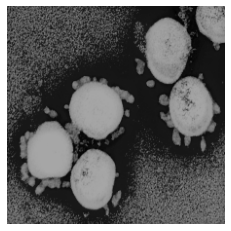

(1, 224, 224, 3)


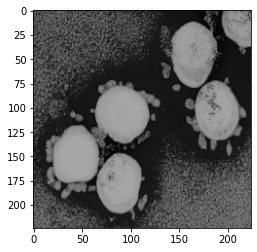

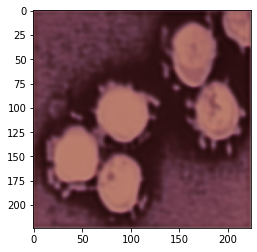

In [129]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }
%matplotlib inline

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

pic_index = 7 #@param {type:"slider", min:1, max:20, step:1}





next_paper = [os.path.join(paper_dir, fname) 
                for fname in paper_files[pic_index-1:pic_index]]


img_path = 0
#for i, img_path in enumerate(next_rock+next_paper+next_scissors):
for i, img_pathany in enumerate(next_paper):
  if True:
    img = mpimg.imread(img_pathany)
    print(img_pathany)
    print(img.shape)
    plt.imshow(img)
    plt.axis('Off')
    plt.show()
    img_path = img_pathany
    break
    
    

img = image.load_img(img_path, target_size=(224, 224))
img_tensor = image.img_to_array(img)
img_tensor = np.expand_dims(img_tensor, axis=0)
# Remember that the model was trained on inputs
# that were preprocessed in the following way:
img_tensor /= 255.

# Its shape is (1, 150, 150, 3)
print(img_tensor.shape)
plt.imshow(img)
plt.show()

predictedimage = model.predict(img_tensor)
plt.imshow(predictedimage[0])

1
32
4
(896, 1792)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:62: RuntimeWarning: invalid value encountered in true_divide


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

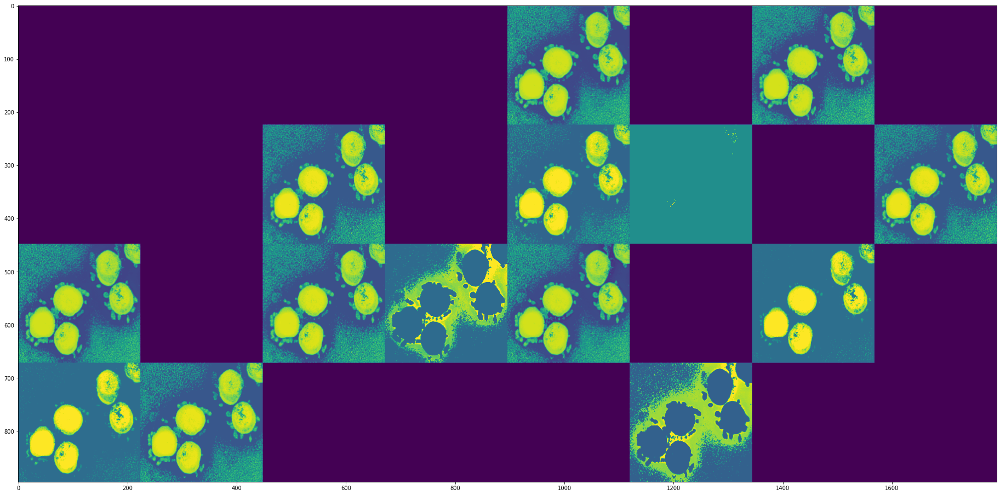

2
32
4
(896, 1792)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

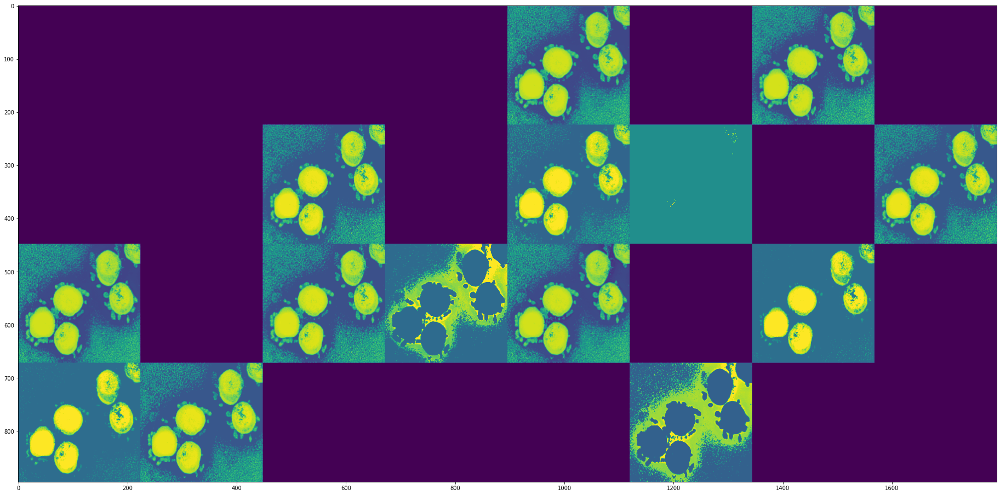

3
32
4
(896, 1792)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

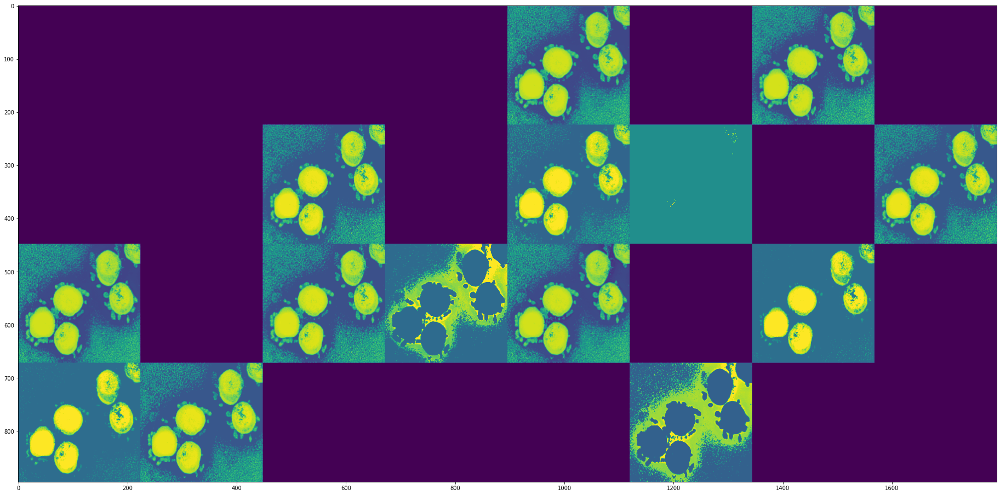

4
16
2
(448, 1792)


<Figure size 2304x576 with 0 Axes>

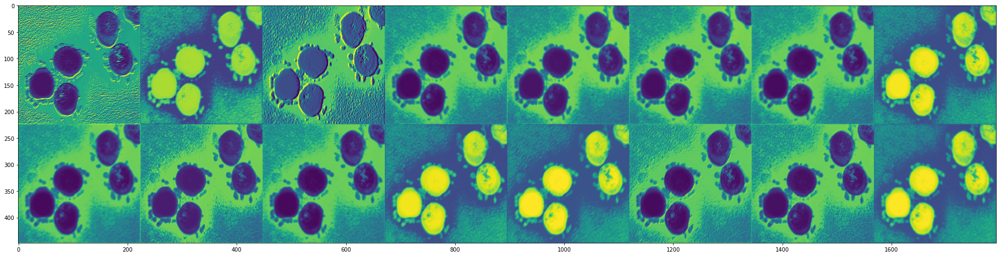

5
16
2
(448, 1792)


<Figure size 2304x576 with 0 Axes>

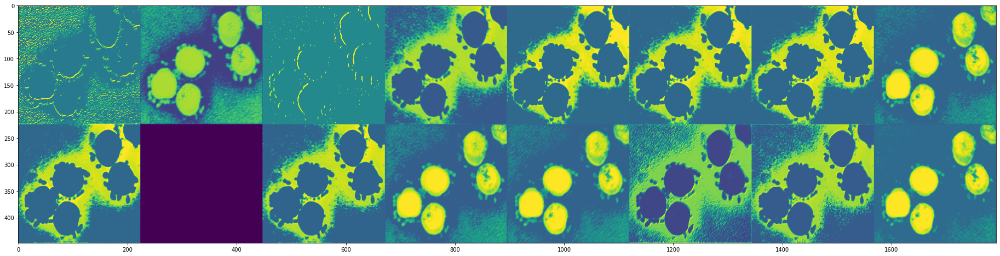

6
16
2
(448, 1792)


<Figure size 2304x576 with 0 Axes>

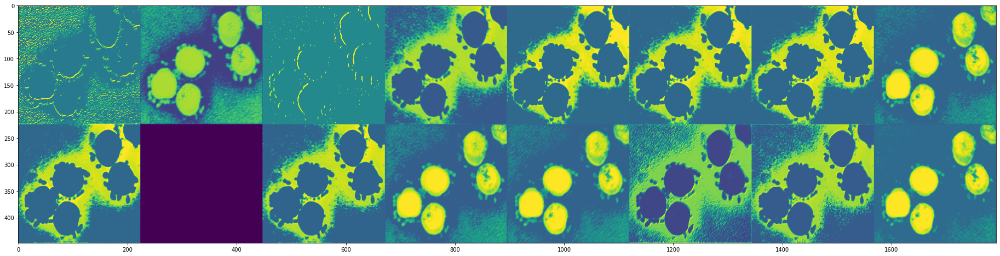

7
16
2
(448, 1792)


<Figure size 2304x576 with 0 Axes>

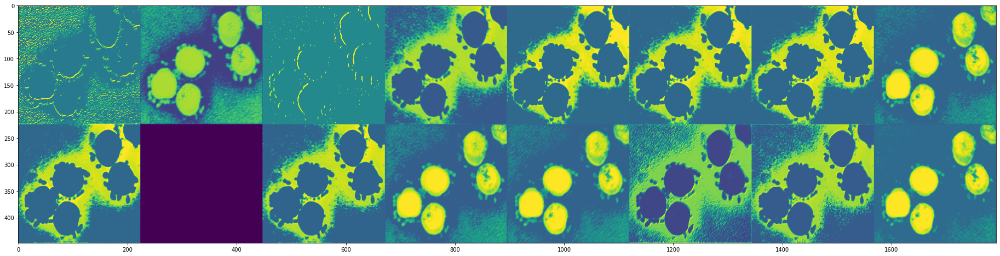

8
8
1
(224, 1792)


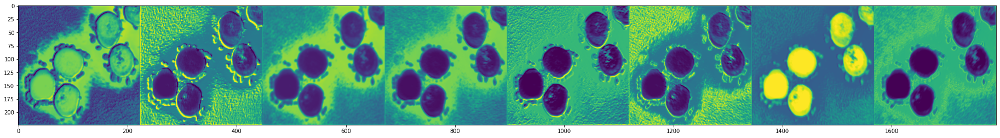

9
8
1
(224, 1792)


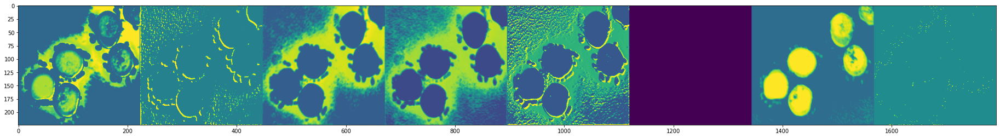

10
8
1
(224, 1792)


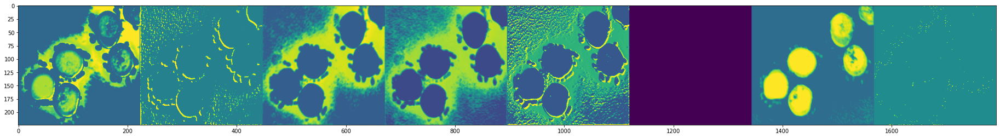

11
8
1
(112, 896)


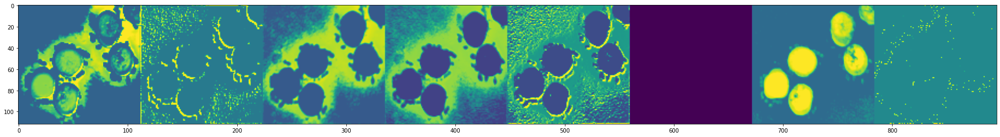

12
4
1
(112, 448)


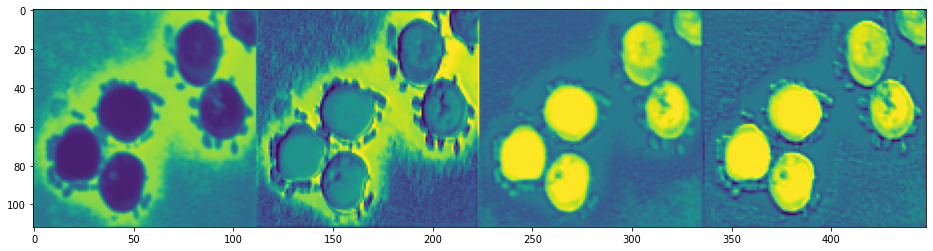

13
4
1
(112, 448)


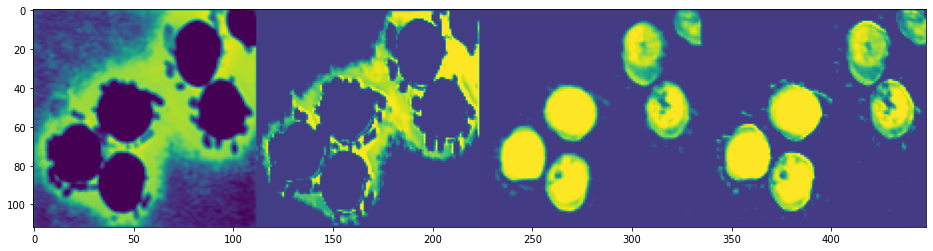

14
4
1
(112, 448)


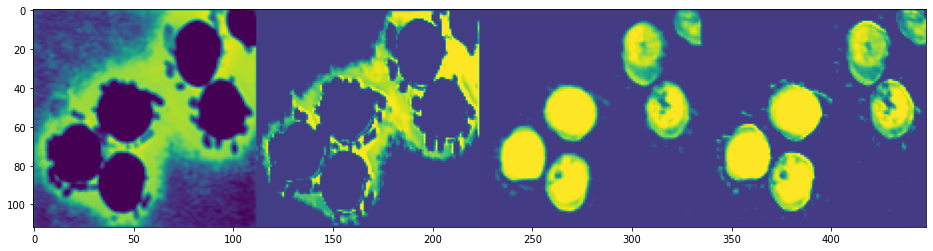

15
8
1
(112, 896)


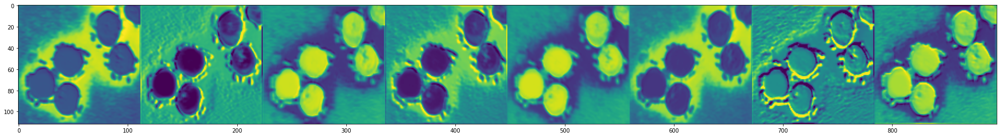

16
8
1
(112, 896)


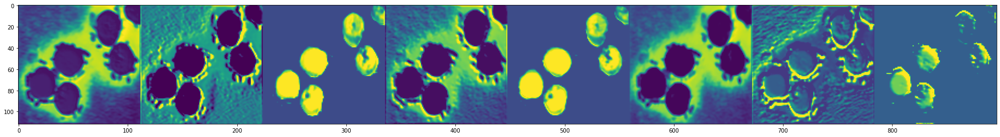

17
8
1
(112, 896)


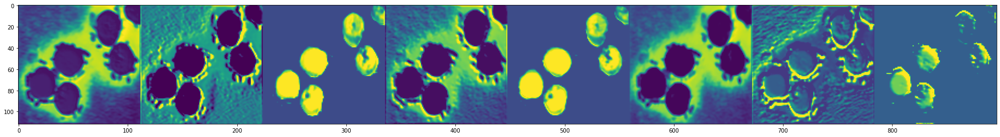

18
16
2
(224, 896)


<Figure size 2304x576 with 0 Axes>

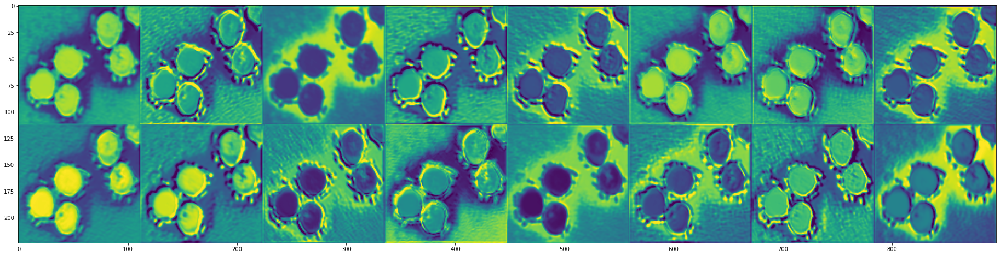

19
16
2
(224, 896)


<Figure size 2304x576 with 0 Axes>

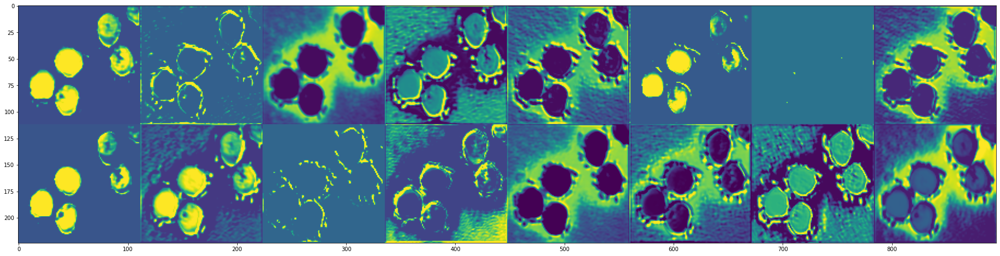

20
16
2
(224, 896)


<Figure size 2304x576 with 0 Axes>

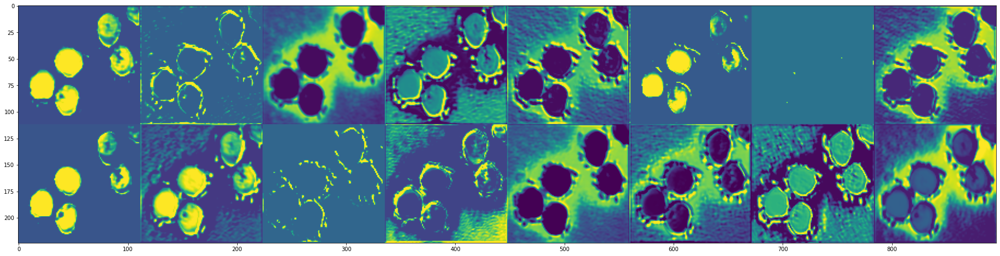

21
32
4
(448, 896)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

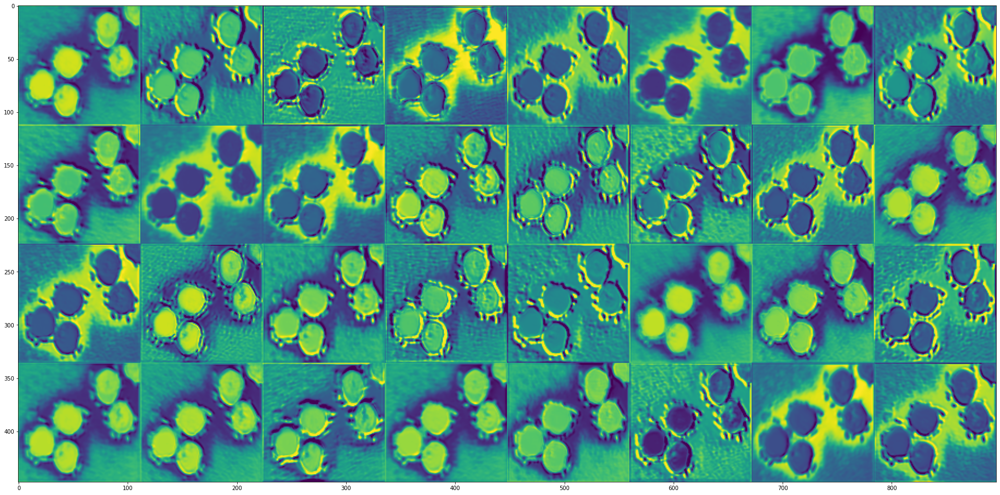

22
32
4
(448, 896)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

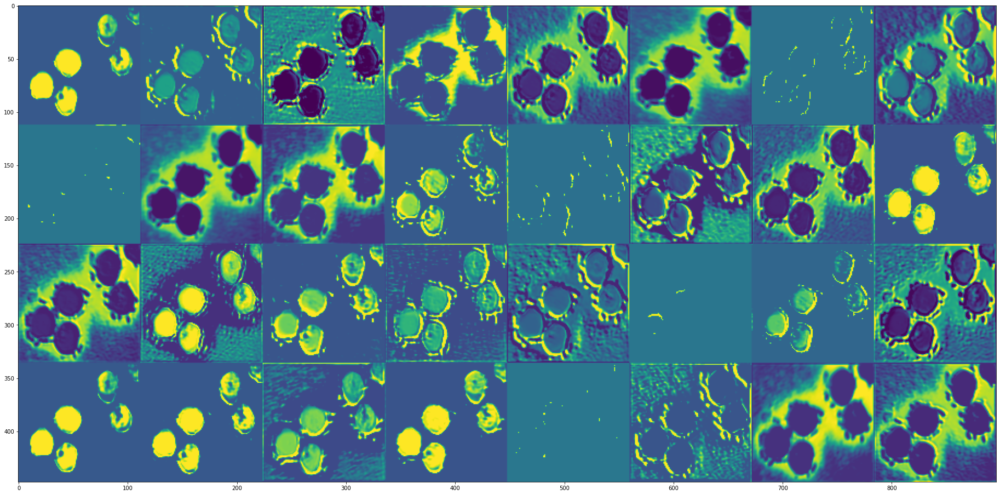

23
32
4
(448, 896)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

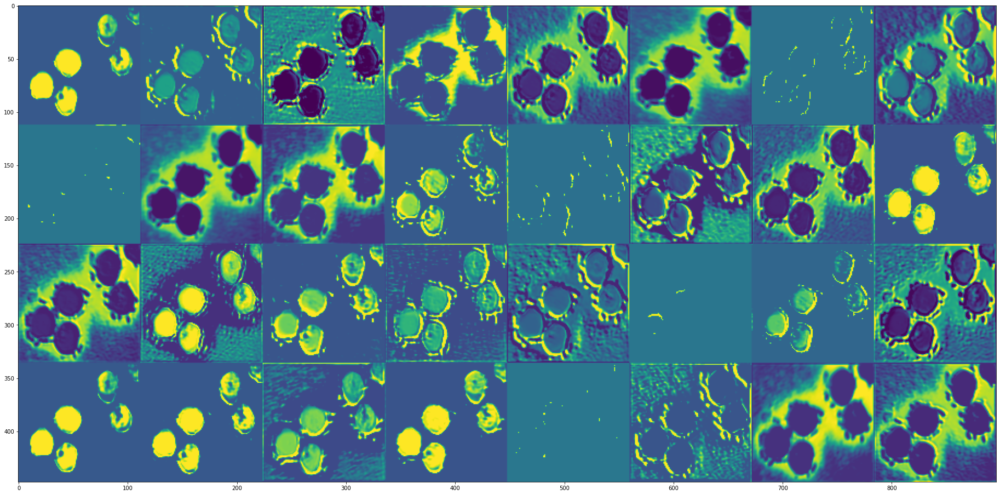

24
32
4
(448, 896)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

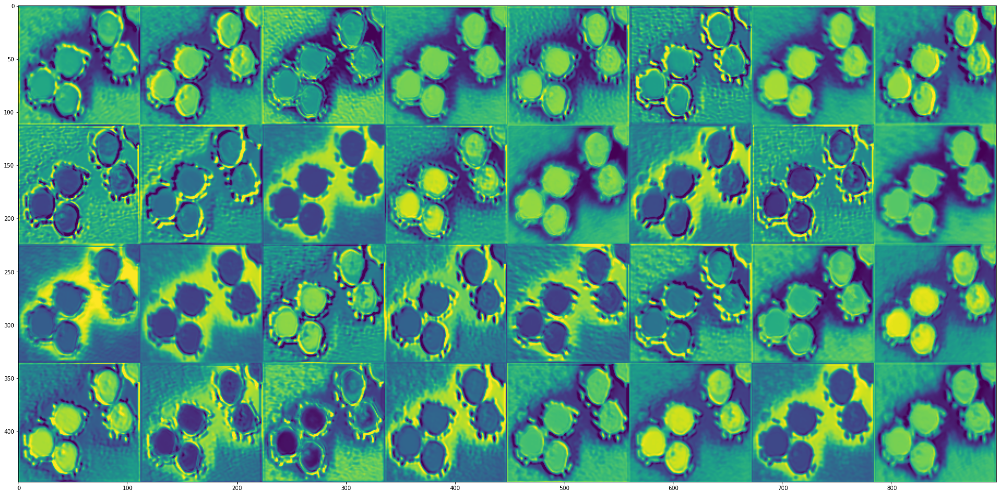

25
32
4
(448, 896)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

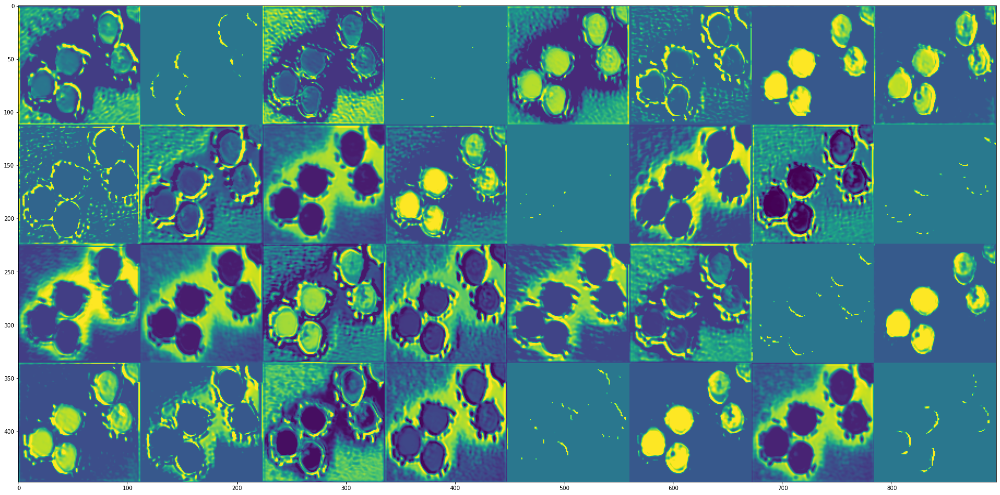

26
32
4
(896, 1792)


<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

<Figure size 2304x1152 with 0 Axes>

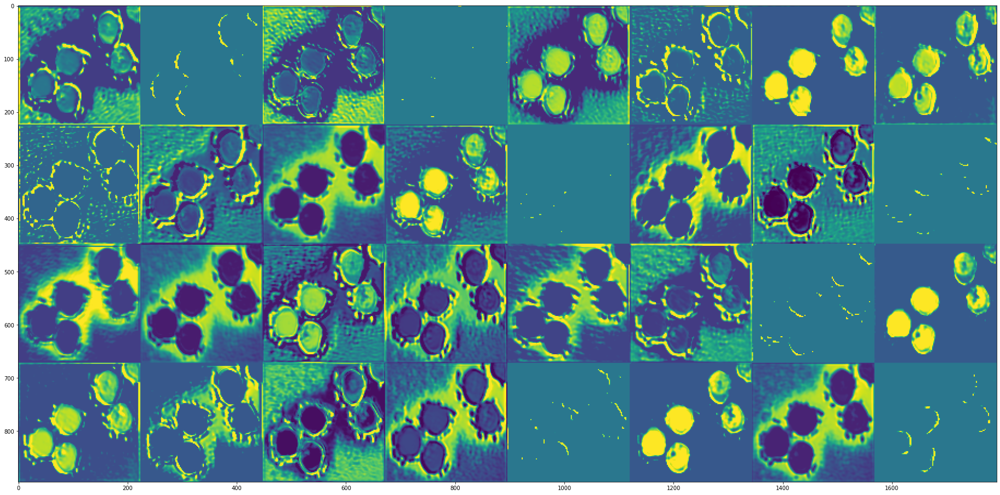

In [130]:
for i in range(1, 27):
  print(i)
  showalayer(i)

In [94]:
#@title Save channel that filter SARS-COV-2 spikes 

Feature1_layernumber = 1 #@param {type:"number"}
Feature1_channelnumber =  4#@param {type:"number"}



In [108]:
#@title Save channel that filter SARS-COV-2 shape 

Feature1a_layernumber = 20 #@param {type:"number"}
Feature1a_channelnumber = 0 #@param {type:"number"}

In [109]:
#@title Save channel that filter SARS-COV-2 spikes 

Feature2_layernumber = 16 #@param {type:"number"}
Feature2_channelnumber =  5#@param {type:"number"}

In [110]:
#@title Save channel that filter SARS-COV-2 spike 

Feature3_layernumber = 17 #@param {type:"number"}
Feature3_channelnumber =  4#@param {type:"number"}

In [ ]:
model

In [79]:
import copy
def plotrequiredchannel(seeActivationAtLayer, channel, isNormalize):
  print('       layer: ' + str(seeActivationAtLayer) + ',  channel: ' + str(channel))
  activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])
  activations = activation_model.predict(img_tensor)
  first_layer_activation = activations[0]
  channelimage = first_layer_activation[:, :, 0+channel:1+channel]
  #print(channelimage.shape[0])   #(56,56)
  sizeofthechannelimage = channelimage.shape[0]  
  newimage22 = np.reshape(channelimage, (sizeofthechannelimage,sizeofthechannelimage))
  newimage23 = copy.deepcopy(newimage22)
  if isNormalize==True:
    newimage22.shape
    newimage22 -= newimage22.mean()
    newimage22 /= newimage22.std()
    newimage22 *= 64
    newimage22 += 128
    newimage22 = np.clip(newimage22, 0, 255).astype('uint8')
    plt.imshow(newimage22)
    print(newimage22.shape)
  else:
    plt.imshow(newimage23)
    print(newimage23.shape)


  return newimage23
   

       layer: 1,  channel: 4
(224, 224)


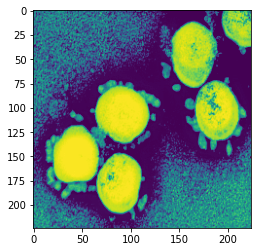

In [131]:
temp = plotrequiredchannel(Feature1_layernumber, Feature1_channelnumber, False)




       layer: 20,  channel: 0
(112, 112)


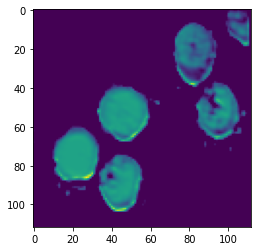

In [132]:
temp = plotrequiredchannel(Feature1a_layernumber, Feature1a_channelnumber, False)


       layer: 16,  channel: 5
(112, 112)


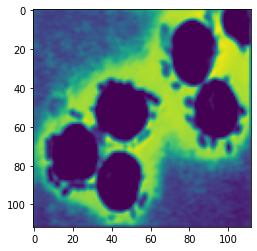

In [133]:
temp = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber, False)

       layer: 17,  channel: 4
(112, 112)


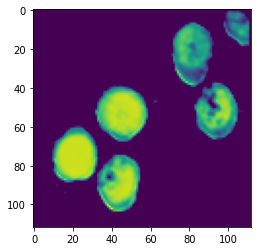

In [134]:
temp = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber, False)

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 31
(224, 224)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:14: RuntimeWarning: invalid value encountered in true_divide
  


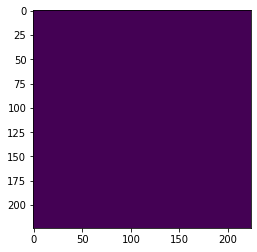

In [76]:
plt.imshow(plotrequiredchannel(1, 14)-plotrequiredchannel(1, 31))

       layer: 3,  channel: 4
(224, 224)


array([[0.22005275, 0.22553954, 0.2383421 , ..., 0.22736847, 0.23102635,
        0.22553954],
       [0.212737  , 0.22188169, 0.21639487, ..., 0.23651317, 0.22736847,
        0.22919741],
       [0.22188169, 0.22188169, 0.22005275, ..., 0.23285529, 0.23468423,
        0.23468423],
       ...,
       [0.21639487, 0.22005275, 0.22919741, ..., 0.22919741, 0.23102635,
        0.22736847],
       [0.22919741, 0.22188169, 0.22553954, ..., 0.22919741, 0.22919741,
        0.23285529],
       [0.22736847, 0.21822381, 0.21639487, ..., 0.22919741, 0.21639487,
        0.22371063]], dtype=float32)

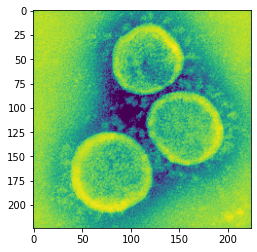

In [116]:

plotrequiredchannel(3, 4, False)

       layer: 1,  channel: 0
(224, 224)
       layer: 3,  channel: 4
(224, 224)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


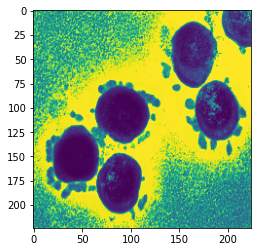

       layer: 1,  channel: 1
(224, 224)
       layer: 3,  channel: 4
(224, 224)


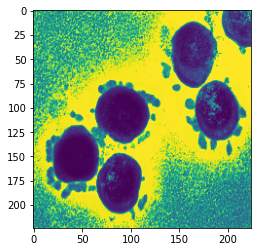

       layer: 1,  channel: 2
(224, 224)
       layer: 3,  channel: 4
(224, 224)


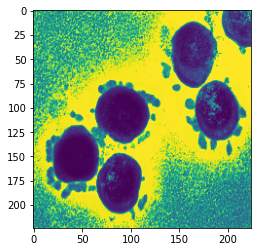

       layer: 1,  channel: 3
(224, 224)
       layer: 3,  channel: 4
(224, 224)


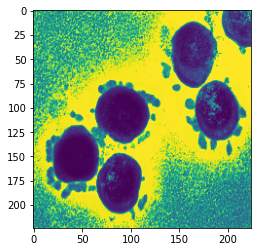

       layer: 1,  channel: 4
(224, 224)
       layer: 3,  channel: 4
(224, 224)


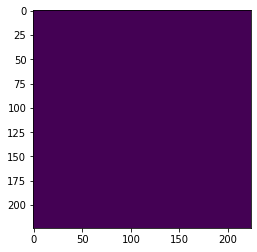

       layer: 1,  channel: 5
(224, 224)
       layer: 3,  channel: 4
(224, 224)


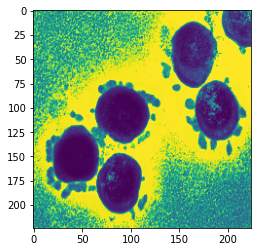

       layer: 1,  channel: 6
(224, 224)
       layer: 3,  channel: 4
(224, 224)


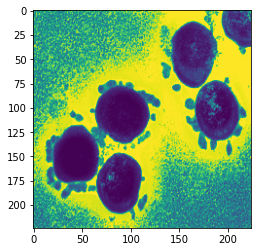

       layer: 1,  channel: 7
(224, 224)
       layer: 3,  channel: 4
(224, 224)


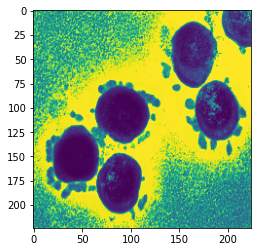

       layer: 1,  channel: 8
(224, 224)
       layer: 3,  channel: 4
(224, 224)


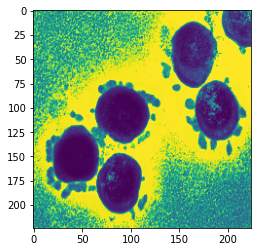

       layer: 1,  channel: 9
(224, 224)
       layer: 3,  channel: 4
(224, 224)


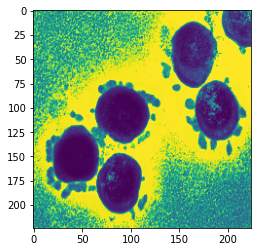

       layer: 1,  channel: 10
(224, 224)
       layer: 3,  channel: 4
(224, 224)


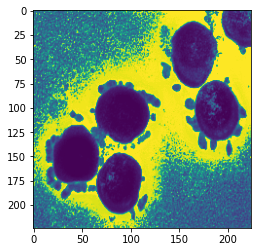

       layer: 1,  channel: 11
(224, 224)
       layer: 3,  channel: 4
(224, 224)


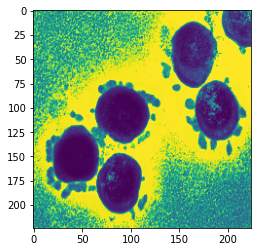

       layer: 1,  channel: 12
(224, 224)
       layer: 3,  channel: 4
(224, 224)


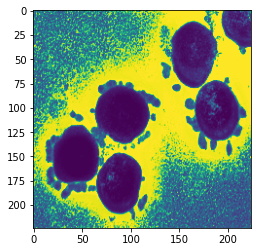

       layer: 1,  channel: 13
(224, 224)
       layer: 3,  channel: 4
(224, 224)


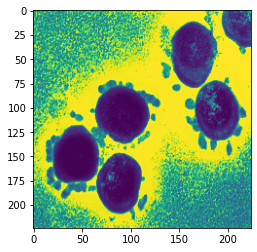

       layer: 1,  channel: 14
(224, 224)
       layer: 3,  channel: 4
(224, 224)


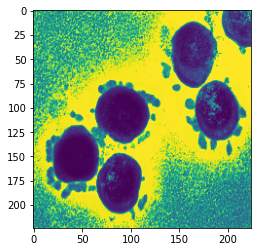

       layer: 1,  channel: 15
(224, 224)
       layer: 3,  channel: 4
(224, 224)


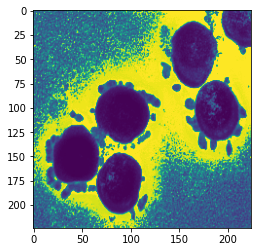

       layer: 1,  channel: 16
(224, 224)
       layer: 3,  channel: 4
(224, 224)


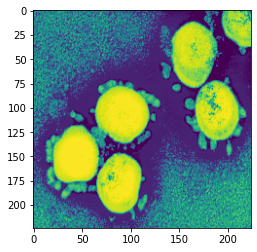

       layer: 1,  channel: 17
(224, 224)
       layer: 3,  channel: 4
(224, 224)


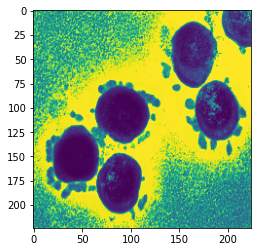

       layer: 1,  channel: 18
(224, 224)
       layer: 3,  channel: 4
(224, 224)


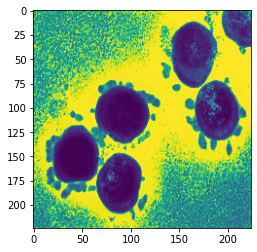

       layer: 1,  channel: 19
(224, 224)
       layer: 3,  channel: 4
(224, 224)


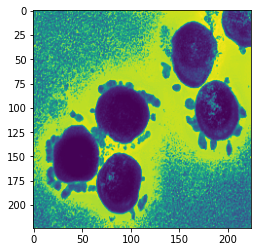

       layer: 1,  channel: 20
(224, 224)
       layer: 3,  channel: 4
(224, 224)


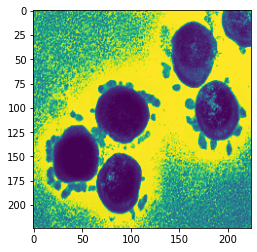

       layer: 1,  channel: 21
(224, 224)
       layer: 3,  channel: 4
(224, 224)


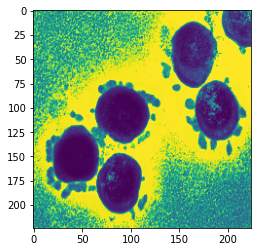

       layer: 1,  channel: 22
(224, 224)
       layer: 3,  channel: 4
(224, 224)


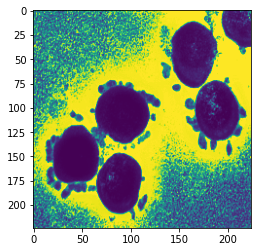

       layer: 1,  channel: 23
(224, 224)
       layer: 3,  channel: 4
(224, 224)


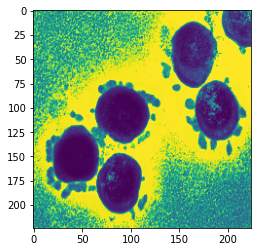

       layer: 1,  channel: 24
(224, 224)
       layer: 3,  channel: 4
(224, 224)


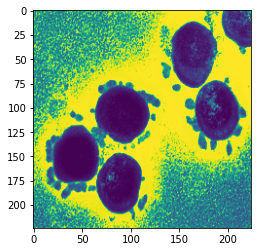

       layer: 1,  channel: 25
(224, 224)
       layer: 3,  channel: 4
(224, 224)


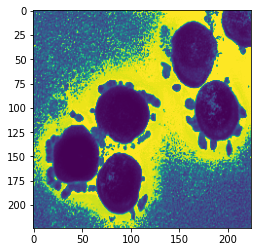

       layer: 1,  channel: 26
(224, 224)
       layer: 3,  channel: 4
(224, 224)


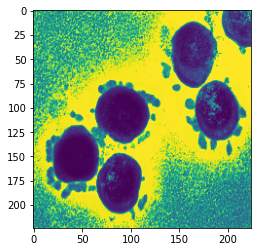

       layer: 1,  channel: 27
(224, 224)
       layer: 3,  channel: 4
(224, 224)


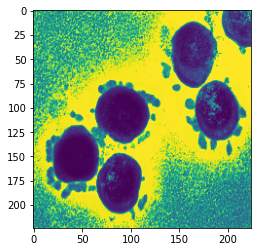

       layer: 1,  channel: 28
(224, 224)
       layer: 3,  channel: 4
(224, 224)


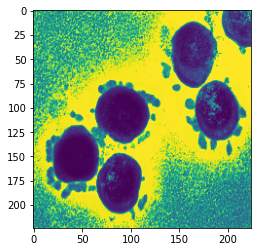

       layer: 1,  channel: 29
(224, 224)
       layer: 3,  channel: 4
(224, 224)


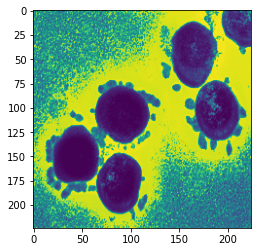

       layer: 1,  channel: 30
(224, 224)
       layer: 3,  channel: 4
(224, 224)


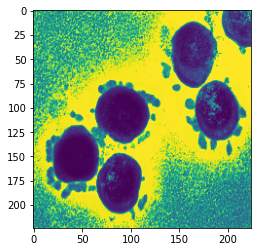

In [135]:

for i in range(0,31):
  imag1 = plotrequiredchannel(1, i, True)
  imag2 = plotrequiredchannel(3, 4, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 1,  channel: 0
(224, 224)
       layer: 1,  channel: 4
(224, 224)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


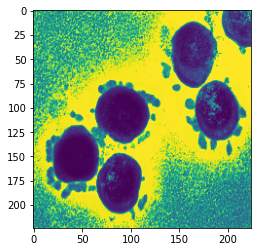

       layer: 1,  channel: 1
(224, 224)
       layer: 1,  channel: 4
(224, 224)


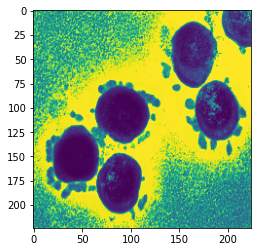

       layer: 1,  channel: 2
(224, 224)
       layer: 1,  channel: 4
(224, 224)


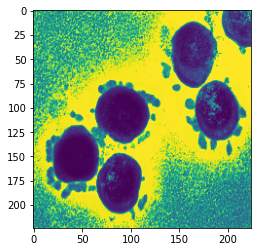

       layer: 1,  channel: 3
(224, 224)
       layer: 1,  channel: 4
(224, 224)


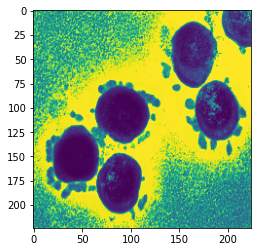

       layer: 1,  channel: 4
(224, 224)
       layer: 1,  channel: 4
(224, 224)


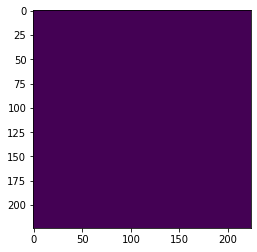

       layer: 1,  channel: 5
(224, 224)
       layer: 1,  channel: 4
(224, 224)


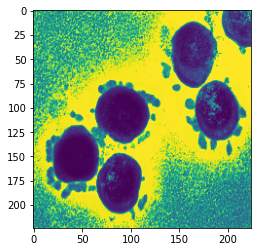

       layer: 1,  channel: 6
(224, 224)
       layer: 1,  channel: 4
(224, 224)


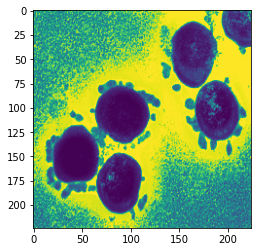

       layer: 1,  channel: 7
(224, 224)
       layer: 1,  channel: 4
(224, 224)


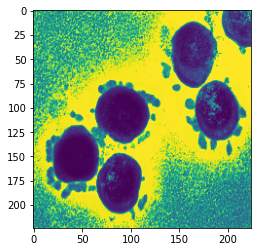

       layer: 1,  channel: 8
(224, 224)
       layer: 1,  channel: 4
(224, 224)


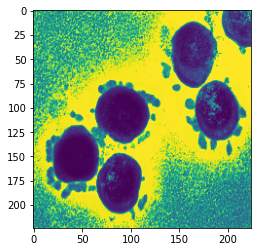

       layer: 1,  channel: 9
(224, 224)
       layer: 1,  channel: 4
(224, 224)


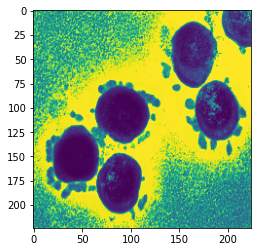

       layer: 1,  channel: 10
(224, 224)
       layer: 1,  channel: 4
(224, 224)


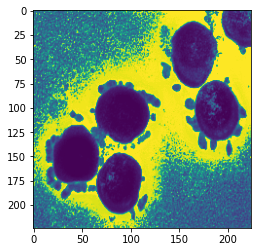

       layer: 1,  channel: 11
(224, 224)
       layer: 1,  channel: 4
(224, 224)


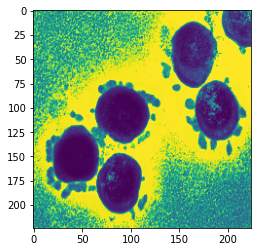

       layer: 1,  channel: 12
(224, 224)
       layer: 1,  channel: 4
(224, 224)


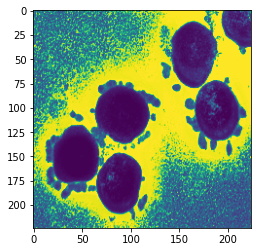

       layer: 1,  channel: 13
(224, 224)
       layer: 1,  channel: 4
(224, 224)


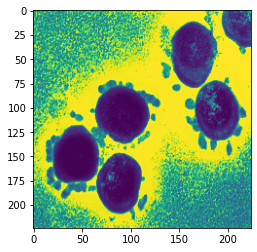

       layer: 1,  channel: 14
(224, 224)
       layer: 1,  channel: 4
(224, 224)


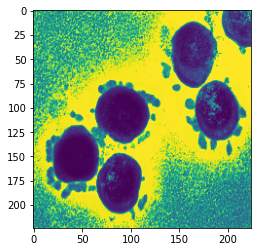

       layer: 1,  channel: 15
(224, 224)
       layer: 1,  channel: 4
(224, 224)


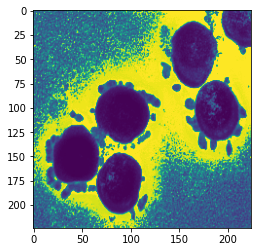

       layer: 1,  channel: 16
(224, 224)
       layer: 1,  channel: 4
(224, 224)


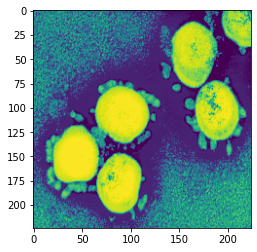

       layer: 1,  channel: 17
(224, 224)
       layer: 1,  channel: 4
(224, 224)


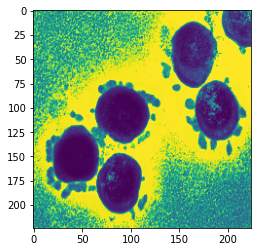

       layer: 1,  channel: 18
(224, 224)
       layer: 1,  channel: 4
(224, 224)


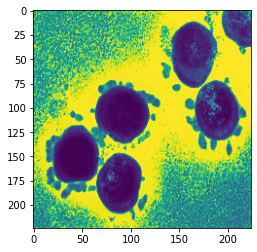

       layer: 1,  channel: 19
(224, 224)
       layer: 1,  channel: 4
(224, 224)


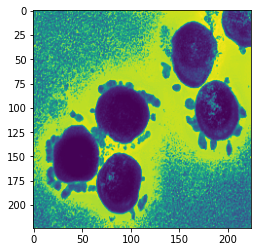

       layer: 1,  channel: 20
(224, 224)
       layer: 1,  channel: 4
(224, 224)


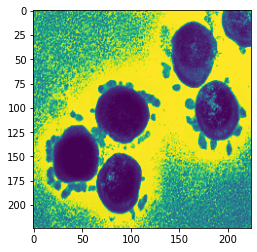

       layer: 1,  channel: 21
(224, 224)
       layer: 1,  channel: 4
(224, 224)


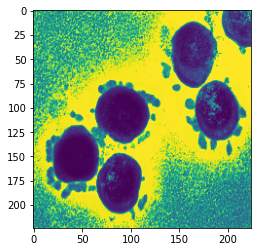

       layer: 1,  channel: 22
(224, 224)
       layer: 1,  channel: 4
(224, 224)


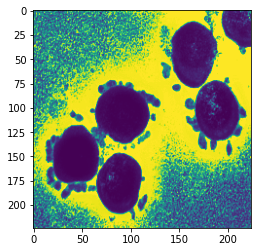

       layer: 1,  channel: 23
(224, 224)
       layer: 1,  channel: 4
(224, 224)


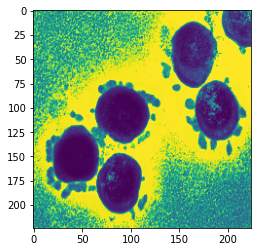

       layer: 1,  channel: 24
(224, 224)
       layer: 1,  channel: 4
(224, 224)


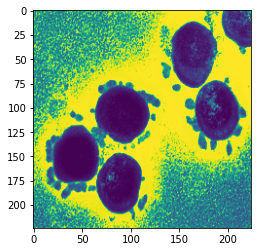

       layer: 1,  channel: 25
(224, 224)
       layer: 1,  channel: 4
(224, 224)


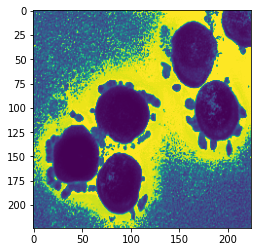

       layer: 1,  channel: 26
(224, 224)
       layer: 1,  channel: 4
(224, 224)


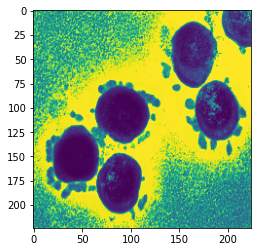

       layer: 1,  channel: 27
(224, 224)
       layer: 1,  channel: 4
(224, 224)


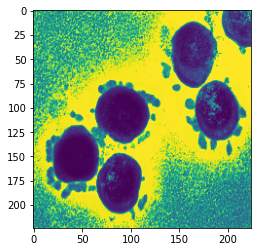

       layer: 1,  channel: 28
(224, 224)
       layer: 1,  channel: 4
(224, 224)


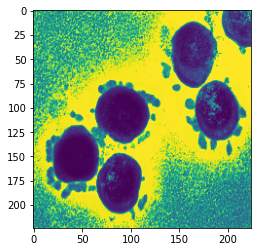

       layer: 1,  channel: 29
(224, 224)
       layer: 1,  channel: 4
(224, 224)


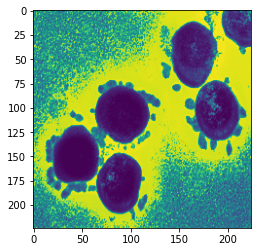

       layer: 1,  channel: 30
(224, 224)
       layer: 1,  channel: 4
(224, 224)


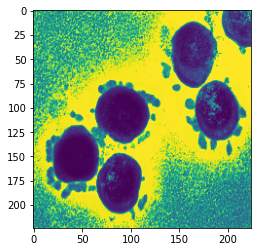

In [138]:

for i in range(0,31):
  imag1 = plotrequiredchannel(1, i, True)
  imag2 = plotrequiredchannel(Feature1_layernumber, Feature1_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 14,  channel: 0
(112, 112)
       layer: 17,  channel: 4
(112, 112)


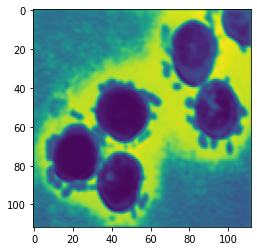

       layer: 14,  channel: 1
(112, 112)
       layer: 17,  channel: 4
(112, 112)


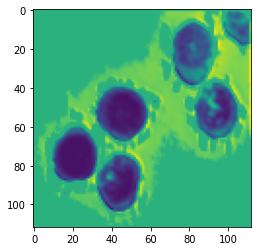

       layer: 14,  channel: 2
(112, 112)
       layer: 17,  channel: 4
(112, 112)


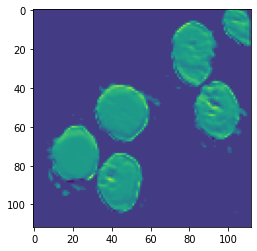

       layer: 14,  channel: 3
(112, 112)
       layer: 17,  channel: 4
(112, 112)


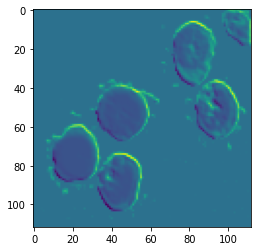

       layer: 14,  channel: 4


ValueError: ignored

In [140]:

for i in range(0,31):
  imag1 = plotrequiredchannel(14, i, True)
  imag2 = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 11,  channel: 0
(112, 112)
       layer: 17,  channel: 4
(112, 112)


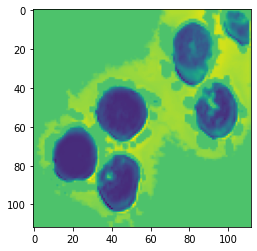

       layer: 11,  channel: 1
(112, 112)
       layer: 17,  channel: 4
(112, 112)


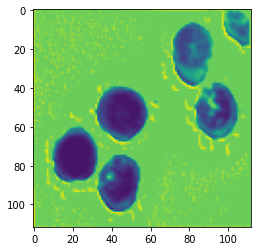

       layer: 11,  channel: 2
(112, 112)
       layer: 17,  channel: 4
(112, 112)


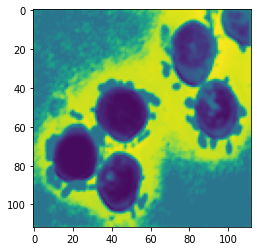

       layer: 11,  channel: 3
(112, 112)
       layer: 17,  channel: 4
(112, 112)


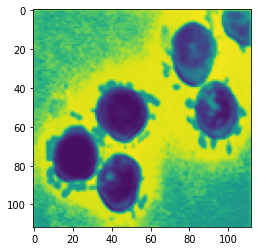

       layer: 11,  channel: 4
(112, 112)
       layer: 17,  channel: 4
(112, 112)


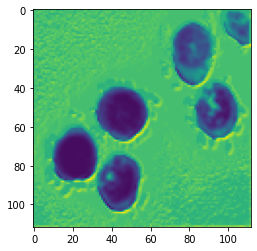

       layer: 11,  channel: 5
(112, 112)
       layer: 17,  channel: 4
(112, 112)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


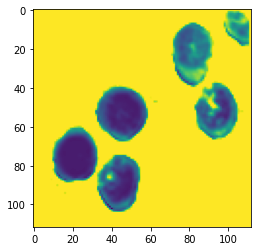

       layer: 11,  channel: 6
(112, 112)
       layer: 17,  channel: 4
(112, 112)


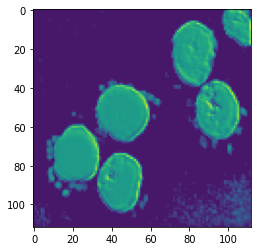

       layer: 11,  channel: 7
(112, 112)
       layer: 17,  channel: 4
(112, 112)


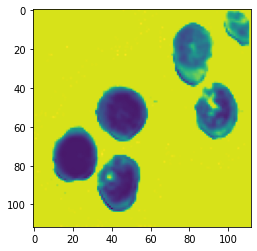

       layer: 11,  channel: 8


ValueError: ignored

In [143]:

for i in range(0,31):
  imag1 = plotrequiredchannel(11, i, True)
  imag2 = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 11,  channel: 0
(112, 112)
       layer: 16,  channel: 5
(112, 112)


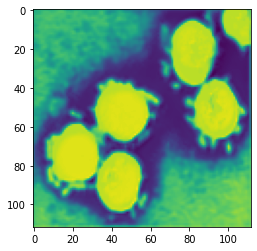

       layer: 11,  channel: 1
(112, 112)
       layer: 16,  channel: 5
(112, 112)


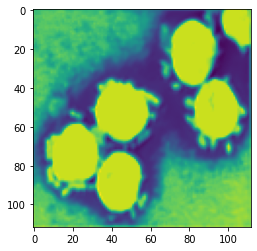

       layer: 11,  channel: 2
(112, 112)
       layer: 16,  channel: 5
(112, 112)


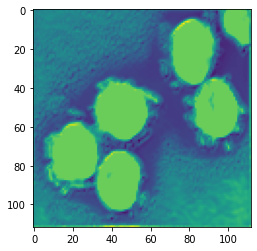

       layer: 11,  channel: 3
(112, 112)
       layer: 16,  channel: 5
(112, 112)


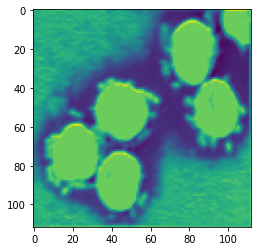

       layer: 11,  channel: 4
(112, 112)
       layer: 16,  channel: 5
(112, 112)


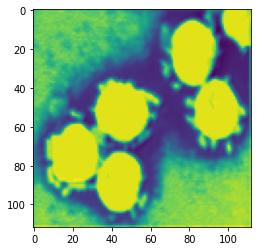

       layer: 11,  channel: 5
(112, 112)
       layer: 16,  channel: 5


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


(112, 112)


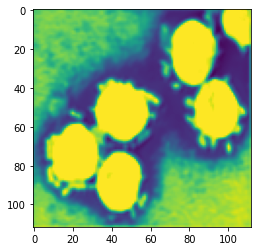

       layer: 11,  channel: 6
(112, 112)
       layer: 16,  channel: 5
(112, 112)


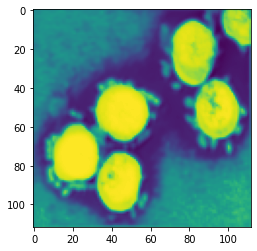

       layer: 11,  channel: 7
(112, 112)
       layer: 16,  channel: 5
(112, 112)


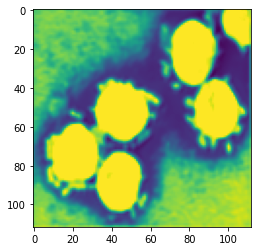

       layer: 11,  channel: 8


ValueError: ignored

In [144]:

for i in range(0,31):
  imag1 = plotrequiredchannel(11, i, True)
  imag2 = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 12,  channel: 0
(112, 112)
       layer: 16,  channel: 5
(112, 112)


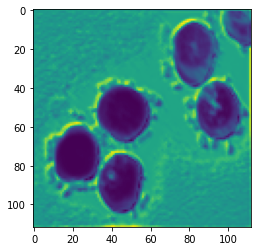

       layer: 12,  channel: 1
(112, 112)
       layer: 16,  channel: 5
(112, 112)


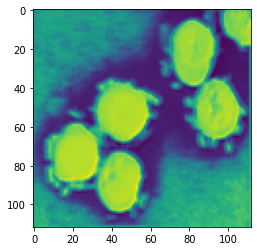

       layer: 12,  channel: 2
(112, 112)
       layer: 16,  channel: 5
(112, 112)


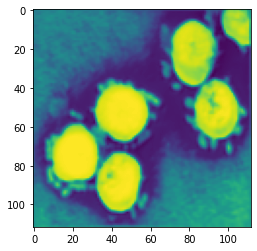

       layer: 12,  channel: 3
(112, 112)
       layer: 16,  channel: 5
(112, 112)


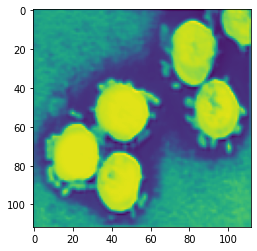

       layer: 12,  channel: 4


ValueError: ignored

In [147]:

for i in range(0,31):
  imag1 = plotrequiredchannel(12, i, False)
  imag2 = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber, False)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 0,  channel: 0
(224, 224)
       layer: 16,  channel: 5
(112, 112)


ValueError: ignored

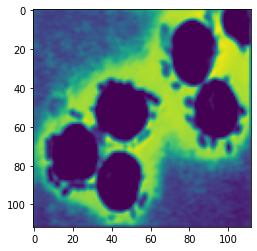

       layer: 18,  channel: 0
(112, 112)
       layer: 17,  channel: 4
(112, 112)


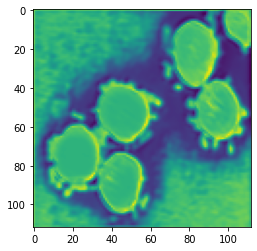

       layer: 18,  channel: 1
(112, 112)
       layer: 17,  channel: 4
(112, 112)


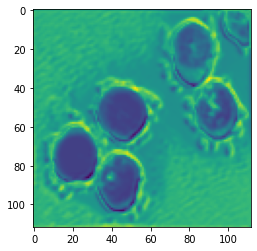

       layer: 18,  channel: 2
(112, 112)
       layer: 17,  channel: 4
(112, 112)


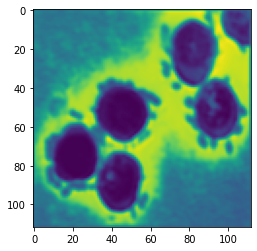

       layer: 18,  channel: 3
(112, 112)
       layer: 17,  channel: 4
(112, 112)


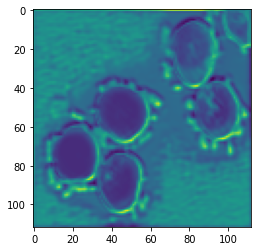

       layer: 18,  channel: 4
(112, 112)
       layer: 17,  channel: 4
(112, 112)


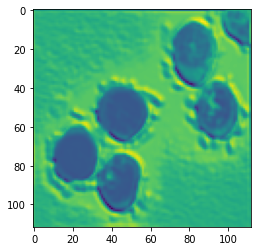

       layer: 18,  channel: 5
(112, 112)
       layer: 17,  channel: 4
(112, 112)


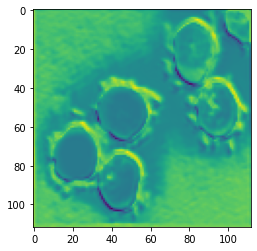

       layer: 18,  channel: 6
(112, 112)
       layer: 17,  channel: 4
(112, 112)


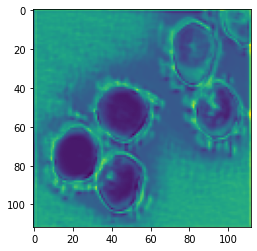

       layer: 18,  channel: 7
(112, 112)
       layer: 17,  channel: 4
(112, 112)


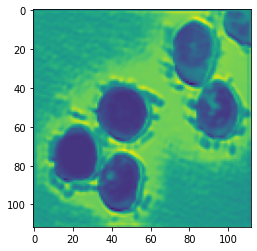

       layer: 18,  channel: 8
(112, 112)
       layer: 17,  channel: 4
(112, 112)


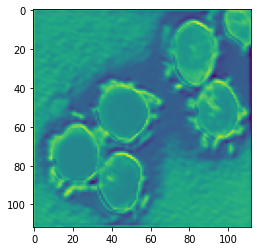

       layer: 18,  channel: 9
(112, 112)
       layer: 17,  channel: 4
(112, 112)


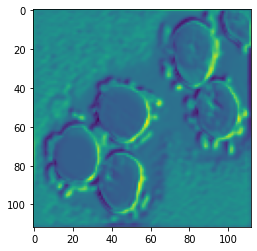

       layer: 18,  channel: 10
(112, 112)
       layer: 17,  channel: 4
(112, 112)


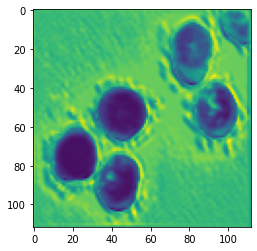

       layer: 18,  channel: 11
(112, 112)
       layer: 17,  channel: 4
(112, 112)


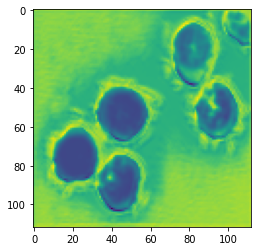

       layer: 18,  channel: 12
(112, 112)
       layer: 17,  channel: 4
(112, 112)


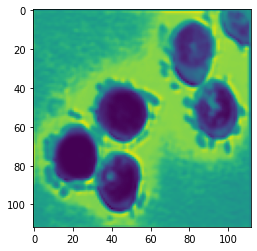

       layer: 18,  channel: 13
(112, 112)
       layer: 17,  channel: 4
(112, 112)


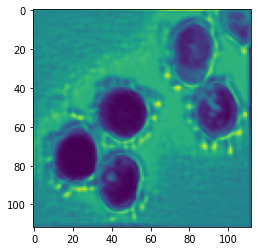

       layer: 18,  channel: 14
(112, 112)
       layer: 17,  channel: 4
(112, 112)


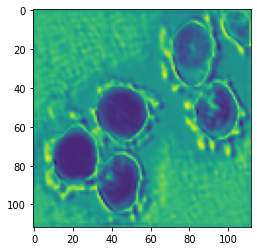

       layer: 18,  channel: 15
(112, 112)
       layer: 17,  channel: 4
(112, 112)


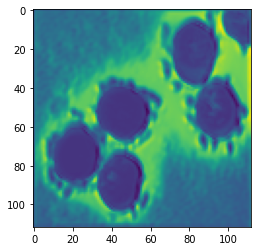

       layer: 18,  channel: 16


ValueError: ignored

In [136]:

for i in range(0,31):
  imag1 = plotrequiredchannel(Feature3_layernumber + 1, i, True)
  imag2 = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 20,  channel: 0
(112, 112)
       layer: 16,  channel: 5
(112, 112)


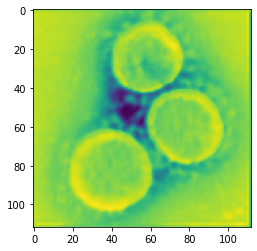

In [125]:
  imag1 = plotrequiredchannel(Feature1a_layernumber , Feature1a_channelnumber, True)
  imag2 = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber, True)
  plt.imshow(imag1-imag2)

       layer: 20,  channel: 0
(112, 112)
       layer: 20,  channel: 0
(112, 112)


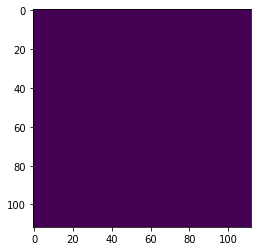

       layer: 20,  channel: 1
(112, 112)
       layer: 20,  channel: 0
(112, 112)


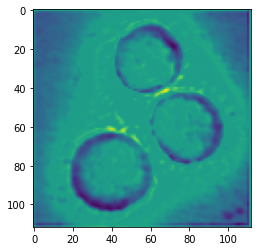

       layer: 20,  channel: 2
(112, 112)
       layer: 20,  channel: 0
(112, 112)


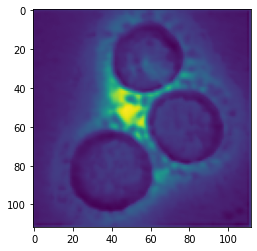

       layer: 20,  channel: 3
(112, 112)
       layer: 20,  channel: 0
(112, 112)


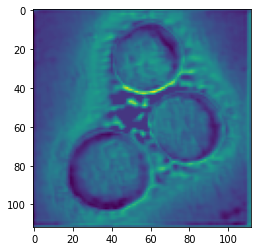

       layer: 20,  channel: 4
(112, 112)
       layer: 20,  channel: 0
(112, 112)


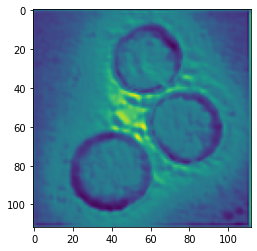

       layer: 20,  channel: 5
(112, 112)
       layer: 20,  channel: 0
(112, 112)


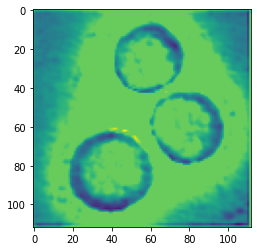

       layer: 20,  channel: 6
(112, 112)
       layer: 20,  channel: 0
(112, 112)


/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:15: RuntimeWarning: invalid value encountered in true_divide
  from ipykernel import kernelapp as app


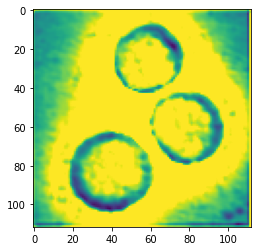

       layer: 20,  channel: 7
(112, 112)
       layer: 20,  channel: 0
(112, 112)


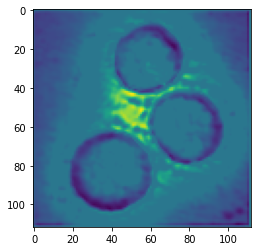

       layer: 20,  channel: 8
(112, 112)
       layer: 20,  channel: 0
(112, 112)


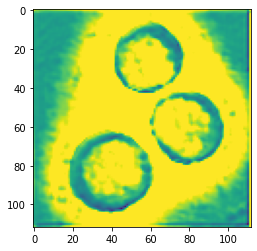

       layer: 20,  channel: 9
(112, 112)
       layer: 20,  channel: 0
(112, 112)


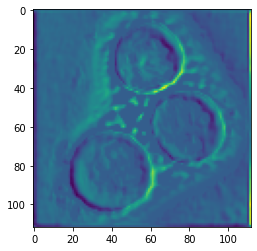

       layer: 20,  channel: 10
(112, 112)
       layer: 20,  channel: 0
(112, 112)


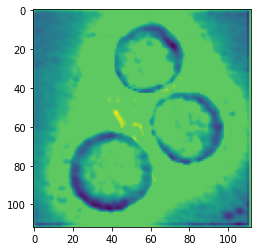

       layer: 20,  channel: 11
(112, 112)
       layer: 20,  channel: 0
(112, 112)


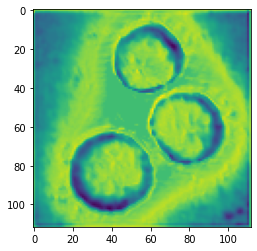

       layer: 20,  channel: 12
(112, 112)
       layer: 20,  channel: 0
(112, 112)


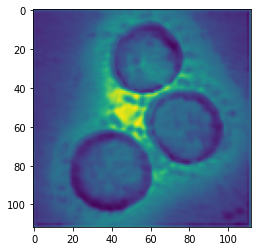

       layer: 20,  channel: 13
(112, 112)
       layer: 20,  channel: 0
(112, 112)


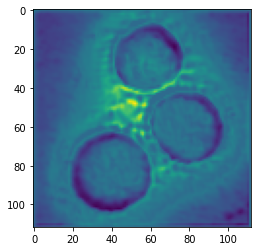

       layer: 20,  channel: 14
(112, 112)
       layer: 20,  channel: 0
(112, 112)


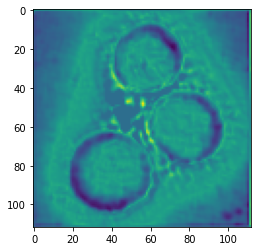

       layer: 20,  channel: 15
(112, 112)
       layer: 20,  channel: 0
(112, 112)


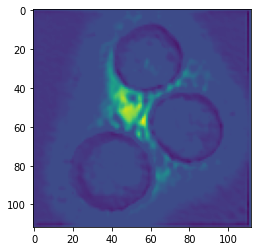

       layer: 20,  channel: 16


ValueError: ignored

In [128]:

for i in range(0,31):
  imag1 = plotrequiredchannel(Feature1a_layernumber , i, True)
  imag2 = plotrequiredchannel(Feature1a_layernumber, Feature1a_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



       layer: 17,  channel: 0
(112, 112)
       layer: 17,  channel: 4
(112, 112)


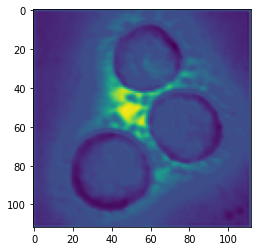

       layer: 17,  channel: 1
(112, 112)
       layer: 17,  channel: 4
(112, 112)


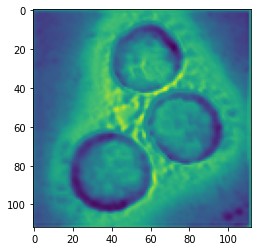

       layer: 17,  channel: 2
(112, 112)
       layer: 17,  channel: 4
(112, 112)


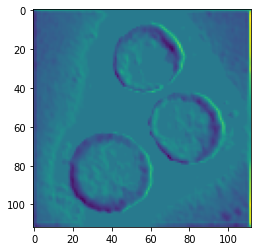

       layer: 17,  channel: 3
(112, 112)
       layer: 17,  channel: 4
(112, 112)


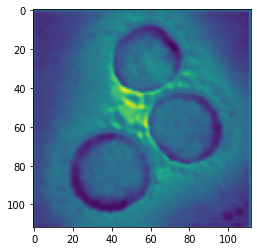

       layer: 17,  channel: 4
(112, 112)
       layer: 17,  channel: 4
(112, 112)


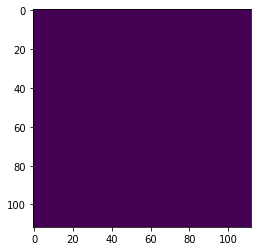

       layer: 17,  channel: 5
(112, 112)
       layer: 17,  channel: 4
(112, 112)


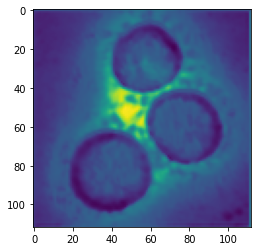

       layer: 17,  channel: 6
(112, 112)
       layer: 17,  channel: 4
(112, 112)


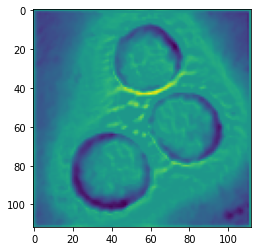

       layer: 17,  channel: 7
(112, 112)
       layer: 17,  channel: 4
(112, 112)


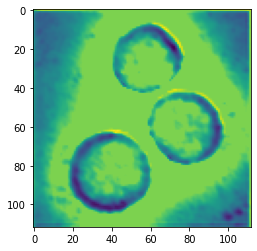

       layer: 17,  channel: 8


ValueError: ignored

In [120]:

for i in range(0,31):
  imag1 = plotrequiredchannel(Feature3_layernumber , i, True)
  imag2 = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber, True)
  plt.imshow(imag1-imag2)
  plt.show()



In [ ]:
#@title After running this cell manually, it will auto-run if you change the selected value. { run: "auto" }

seeActivationAtLayer = "13" #@param [1, 2, 3, 4, 5, 6, 7, 9, 11, 13, 14, 15, 16,17, 19, 22, 25, 26, 27, 28]

seeActivationAtLayer = int (seeActivationAtLayer)

from keras import models
layer_outputs = [layer.output for layer in model.layers]

activation_model = 0
activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])



activations = activation_model.predict(img_tensor)
first_layer_activation = activations[0]

layer_activation = activations[0]

images_per_row = 16

n_features = layer_activation.shape[-1]

n_features

if n_features <= 4: 
  images_per_row = 2

if n_features <= 2: 
  images_per_row = 1
    
  
size = layer_activation.shape[1]

n_cols = n_features // images_per_row
display_grid = np.zeros((size * n_cols, images_per_row * size))

n_features = layer_activation.shape[-1]
size = layer_activation.shape[1]


print(n_features)

n_cols = n_features // images_per_row



display_grid =0
display_grid = np.zeros((size * n_cols, images_per_row * size))

print(n_cols)
print(display_grid.shape)

# We'll tile each filter into this big horizontal grid
if True:
  for col in range(n_cols):
    for row in range(images_per_row):
              channel_image = layer_activation[
                                               :, :,
                                               col * images_per_row + row]
              # Post-process the feature to make it visually palatable
              channel_image -= channel_image.mean()
              channel_image /= channel_image.std()
              channel_image *= 64
              channel_image += 128
              channel_image = np.clip(channel_image, 0, 255).astype('uint8')
             # print(channel_image.shape)
             # print(col * size)
             # print((col + 1) * size)
              display_grid[col * size : (col + 1) * size,
                           row * size : (row + 1) * size] = channel_image

    # Display the grid
    scale = 1. / size * 2
    plt.figure(figsize=(scale * display_grid.shape[1] * 2 ,
                          scale * 2 * display_grid.shape[0]))
  plt.imshow(display_grid, aspect='auto', cmap='viridis')
    
plt.show()


from keras.utils import plot_model
plot_model(activation_model, show_shapes=True, show_layer_names=False, to_file='model.png')

In [ ]:
#@title Save channel that filter SARS-COV-2 spikes 

Feature1_layernumber = 1 #@param {type:"number"}
Feature1_channelnumber = 1 #@param {type:"number"}



In [ ]:
#@title Save channel that filter SARS-COV-2 shape 

Feature1a_layernumber = 16 #@param {type:"number"}
Feature1a_channelnumber = 5 #@param {type:"number"}

In [ ]:
#@title Save channel that filter SARS-COV-2 shape 

Feature2_layernumber = 3 #@param {type:"number"}
Feature2_channelnumber = 3 #@param {type:"number"}

In [ ]:
#@title Save channel that filter SARS-COV-2 shape 

Feature3_layernumber = 1 #@param {type:"number"}
Feature3_channelnumber = 2 #@param {type:"number"}

In [ ]:
import copy
def plotrequiredchannel(seeActivationAtLayer, channel):
  print('       layer: ' + str(seeActivationAtLayer) + ',  channel: ' + str(channel))
  activation_model = models.Model(model.input, outputs=layer_outputs[seeActivationAtLayer])
  activations = activation_model.predict(img_tensor)
  first_layer_activation = activations[0]
  channelimage = first_layer_activation[:, :, 0+channel:1+channel]
  #print(channelimage.shape[0])   #(56,56)
  sizeofthechannelimage = channelimage.shape[0]  
  newimage22 = np.reshape(channelimage, (sizeofthechannelimage,sizeofthechannelimage))
  newimage23 = copy.deepcopy(newimage22)
  newimage22.shape
  newimage22 -= newimage22.mean()
  newimage22 /= newimage22.std()
  newimage22 *= 64
  newimage22 += 128
  newimage22 = np.clip(newimage22, 0, 255).astype('uint8')
  plt.imshow(newimage22)
  print(newimage22.shape)
  return newimage23
   

In [ ]:
temp = plotrequiredchannel(Feature1_layernumber, Feature1_channelnumber)


In [ ]:
temp = plotrequiredchannel(Feature1a_layernumber, Feature1a_channelnumber)


In [ ]:
temp = plotrequiredchannel(Feature2_layernumber, Feature2_channelnumber)


In [ ]:
temp = plotrequiredchannel(Feature3_layernumber, Feature3_channelnumber)


In [ ]:

plt.imshow(plotrequiredchannel(1, 19)-plotrequiredchannel(1, 2))

In [ ]:
plt.imshow(plotrequiredchannel(1, 14)-plotrequiredchannel(1, 31))

In [ ]:

plotrequiredchannel(1, 1)



In [ ]:
plotrequiredchannel(3, 63)


In [ ]:
plotrequiredchannel(6, 125)


In [ ]:
plotrequiredchannel(1, 2)


In [ ]:
plotrequiredchannel(2, 31)


In [ ]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 2)
  plt.imshow(imag1-imag2)
  plt.show()


In [ ]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 31)
  print(i)
  plt.imshow(imag1-imag2)
  plt.show()


In [ ]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 2)
  plt.imshow(imag1-imag2)
  plt.show()


In [ ]:
for i in range(0,31):
  imag1 = plotrequiredchannel(3, i)
  imag2 = plotrequiredchannel(3, 0)
  print(i)
  plt.imshow(imag1-imag2)
  plt.show()

In [ ]:
plotrequiredchannel(1, 2)


In [ ]:
plotrequiredchannel(1, 14)


In [ ]:
for i in range(0,31):
  imag1 = plotrequiredchannel(1, i)
  imag2 = plotrequiredchannel(1, 14)
  plt.imshow(imag1-imag2)
  plt.show()


In [ ]:
plotrequiredchannel(1, 31)


In [ ]:
plotrequiredchannel(1, 31)


In [ ]:
grads = K.gradients(loss, model.input)[0]


In [ ]:
grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)


In [ ]:
iterate = K.function([model.input], [loss, grads])

# Let's test it:
import numpy as np
loss_value, grads_value = iterate([np.zeros((1, 150, 150, 3))])

In [ ]:
# We start from a gray image with some noise
input_img_data = np.random.random((1, 150, 150, 3)) * 20 + 128.

# Run gradient ascent for 40 steps
step = 1.  # this is the magnitude of each gradient update
for i in range(40):
    # Compute the loss value and gradient value
    loss_value, grads_value = iterate([input_img_data])
    # Here we adjust the input image in the direction that maximizes the loss
    input_img_data += grads_value * step

In [ ]:
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + 1e-5)
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
def generate_pattern(layer_name, filter_index, size=150):
    # Build a loss function that maximizes the activation
    # of the nth filter of the layer considered.
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])

    # Compute the gradient of the input picture wrt this loss
    grads = K.gradients(loss, model.input)[0]

    # Normalization trick: we normalize the gradient
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)

    # This function returns the loss and grads given the input picture
    iterate = K.function([model.input], [loss, grads])
    
    # We start from a gray image with some noise
    input_img_data = np.random.random((1, size, size, 3)) * 20 + 128.

    # Run gradient ascent for 40 steps
    step = 1.
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
        
    img = input_img_data[0]
    return deprocess_image(img)

In [ ]:
plt.imshow(generate_pattern('conv2d_4', 3))
plt.show()

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec



for j in range(2):
  
  plt.figure(figsize = (16,16))
  gs1 = gridspec.GridSpec(4, 4)
  gs1.update(wspace=0.005, hspace=0.005) # set the spacing between axes. 

  for i in range(16):
     # i = i + 1 # grid spec indexes from 0

      img = generate_pattern('conv2d_3', i + 16*j)

      ax1 = plt.subplot(gs1[i])
      plt.axis('off')
      ax1.set_aspect('equal')
      plt.imshow(img)

  plt.show()

In [ ]:

import os
logdir = os.path.join("logs", "myexp1")
tensorboard_callback = keras.callbacks.TensorBoard(logdir, histogram_freq=1)


In [ ]:
import tensorflow as tf



In [ ]:
load_ext tensorboard


In [ ]:
%reload_ext tensorboard

In [ ]:
#!kill 426

In [ ]:
activation_model.summary()

In [ ]:
from keras.utils import plot_model
plot_model(activation_model, to_file='model.png')

In [ ]:
%tensorboard — logdir logs


In [ ]:
data_list[0].shape

In [ ]:
data_list[0][19].shape